<a class="anchor" id="0"></a>
# **Comprehensive Data Analysis with Pandas (BlackFriday Dataset)**


This project demonstrates exploratory data analysis (EDA) on the BlackFriday dataset using Python Pandas. 
The focus is on data understanding, filtering, and deriving insights.



- Rows: 550,068
- Columns: 12
- Tools: Pandas, NumPy


### Exploratory Data Analysis
### Data Filtering & Querying
### Aggregation & Insights


In [1]:
import pandas as pd
import numpy as np 

In [2]:
data = "train.csv"
df = pd.read_csv("train.csv")

## Exploratory Data Analysis (EDA).

### view the first five rows of the dataframe


We can view the first 5 rows of the dataframe with **head()** method as follows:-

In [3]:
df.head().style.set_table_styles(
    [{
        'selector': 'th',
        'props': [('background-color', '#4CAF50'),
                  ('color', 'white'),
                  ('font-size', '12px'),
                  ('text-align', 'center')]
    },
    {
        'selector': 'td',
        'props': [('padding', '6px')]
    }]
).set_properties(**{
    'border': '1px solid #ddd',
    'text-align': 'center'
})


,User_ID,Product_ID,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category_1,Product_Category_2,Product_Category_3,Purchase
0,1000001,P00069042,F,0-17,10,A,2,0,3,nan,nan,8370
1,1000001,P00248942,F,0-17,10,A,2,0,1,6.000000,14.000000,15200
2,1000001,P00087842,F,0-17,10,A,2,0,12,nan,nan,1422
3,1000001,P00085442,F,0-17,10,A,2,0,12,14.000000,nan,1057
4,1000002,P00285442,M,55+,16,C,4+,0,8,nan,nan,7969


### check the type of df


In [4]:
type(df)

pandas.core.frame.DataFrame

### check shape of dataframe


In [5]:
df.shape

(550068, 12)

#### In this dataset We have 550068 Rows And 12 Columns .

### view concise summary of dataframe

We can view the concise summary of dataframe with **info()** method as follows:-

In [6]:
from rich.console import Console
from rich.table import Table
from rich.live import Live
from time import sleep

def pretty_info_animated(df):
    console = Console()

    with Live(console=console, refresh_per_second=8) as live:
        table = Table(title="✨ DataFrame Info (Animated) ✨", show_lines=True)
        table.add_column("Column", style="bold cyan")
        table.add_column("Non-Null Count", style="bold green")
        table.add_column("Dtype", style="bold magenta")

        # Animation: load columns one by one
        for col in df.columns:
            nn = df[col].notnull().sum()
            table.add_row(f"[cyan]{col}", f"[green]{nn}", f"[magenta]{df[col].dtype}")
            live.update(table)
            sleep(0.15)  # animation speed

        sleep(0.3)
        table.add_row("📏 Shape", f"{df.shape[0]} rows", f"{df.shape[1]} cols")
        table.add_row("💾 Memory", f"{df.memory_usage(deep=True).sum()/1024**2:.2f} MB", "-")
        live.update(table)


In [7]:
pretty_info_animated(df)



Output()

#### Here We can see most of the data is numberd and only 5 column have object .

**We can check the total number of missing values in each column in the dataset with the following command:-**

In [8]:
import pandas as pd

# Missing value summary
s = df.isnull().sum().rename('missing').to_frame()
s['pct'] = (s['missing'] / len(df)) * 100
s = s.sort_values('missing', ascending=False)

# Move index to column
s = s.reset_index().rename(columns={'index': 'Column Name'})

# Style formatting
sty = s.style.format({'missing':'{:d}','pct':'{:.1f}%'})

# Remove gradient, keep attractive bar
sty = sty.bar(subset=['missing'], vmin=0, vmax=s['missing'].max(), color='#4CAF50')  # green bar

# Table styles
sty = sty.set_table_styles([
    {'selector':'tr:hover',
     'props':[('background-color','#fff2a8')]},
    {'selector':'th',
     'props':[('position','sticky'),
              ('top','0'),
              ('background','#1976D2'),   # deep blue header
              ('color','white'),
              ('font-size','13px'),
              ('text-align','center'),
              ('border','2px solid #444')]},
    {'selector':'td',
     'props':[('border','1px solid #ccc'),
              ('padding','6px'),
              ('text-align','center')]}
])

display(sty)

,Column Name,missing,pct
0,Product_Category_3,383247,69.7%
1,Product_Category_2,173638,31.6%
2,User_ID,0,0.0%
3,Product_ID,0,0.0%
4,Age,0,0.0%
5,Gender,0,0.0%
6,Occupation,0,0.0%
7,City_Category,0,0.0%
8,Marital_Status,0,0.0%
9,Stay_In_Current_City_Years,0,0.0%


#### Almost All column got 0 null values But **Product_Category_2** & **Product_Category_2** got 173638 & 383247 NULL values resp.

##### df.isna().sum() method work same as .isnull().sum() 

In [9]:
import pandas as pd

# Missing value summary
missing = df.isna().sum().rename('missing').to_frame()
missing['pct'] = (missing['missing'] / len(df)) * 100
top = missing.sort_values('missing', ascending=False).head(10)

# Move index (column names) into a proper column
top = top.reset_index().rename(columns={'index': 'Column Name'})

# Style formatting
styled = (
    top.style
    .format({'missing': '{:,}', 'pct': '{:.1f}%'})
    .bar(subset=['missing'], vmin=0, vmax=top['missing'].max(), color='#4CAF50')   # attractive green bar
    .background_gradient(subset=['pct'], cmap='PuBuGn')  # teal-blue gradient
    .set_table_styles([
        {'selector': 'thead th',
         'props': [('background-color', '#1976D2'),   # deep blue header
                   ('color', 'white'),
                   ('font-size', '13px'),
                   ('text-align', 'center'),
                   ('border', '2px solid #444')]},
        {'selector': 'td',
         'props': [('border', '1px solid #444'),      # perfect cell borders
                   ('padding', '6px'),
                   ('text-align', 'center')]},
        {'selector': 'tr:hover',
         'props': [('background-color', '#fff2cc'),
                   ('cursor', 'pointer')]}
    ])
    .set_table_attributes('class="dataframe table-hover" style="border-collapse:collapse"')
    .set_caption('Top 10 columns by missing values')
)

display(styled)

,Column Name,missing,pct
0,Product_Category_3,"383,247",69.7%
1,Product_Category_2,"173,638",31.6%
2,User_ID,0,0.0%
3,Product_ID,0,0.0%
4,Age,0,0.0%
5,Gender,0,0.0%
6,Occupation,0,0.0%
7,City_Category,0,0.0%
8,Marital_Status,0,0.0%
9,Stay_In_Current_City_Years,0,0.0%


### let's fill the null values by ffill method.

In [10]:
df = df.ffill()

In [11]:
import pandas as pd
from IPython.display import HTML, display

s = df.isnull().sum().sort_values(ascending=False)

html = """
<style>
.tbl {
  font-family: Arial;
  border-collapse: collapse;
  width: 100%;
}
.tbl td, .tbl th {
  padding: 8px 12px;
  border: 1px solid #444;   /* full border around every cell */
  text-align: center;
}
.tbl th {
  background: #1976D2;      /* deep blue header */
  color: white;
  font-size: 13px;
}
.tbl tr:nth-child(even) {
  background: #f9f9f9;      /* light gray for even rows */
}
.tbl tr:nth-child(odd) {
  background: #ffffff;      /* white for odd rows */
}
.tbl tr:hover {
  background: #e3f2fd;      /* soft blue hover */
  cursor: pointer;
}
.sel {
  background: #bbdefb !important; /* highlight selected row */
  font-weight: bold;
}
</style>

<table id='t' class='tbl'>
<tr><th>Column</th><th>Missing</th></tr>
"""

for c, v in s.items():
    html += f"<tr><td>{c}</td><td>{v}</td></tr>"

html += """
</table>

<script>
let rows = [...document.querySelectorAll('#t tr')].slice(1);
let i = 0;
function mark(){
  rows.forEach(r=>r.classList.remove('sel'));
  rows[i].classList.add('sel');
  rows[i].scrollIntoView({block:'nearest'});
}
mark();

document.addEventListener('keydown',e=>{
  if(e.key=='ArrowDown'){i=Math.min(rows.length-1,i+1);mark();}
  if(e.key=='ArrowUp'){i=Math.max(0,i-1);mark();}
});
</script>
"""

display(HTML(html))

Column,Missing
Product_Category_2,1
Product_Category_3,1
User_ID,0
Product_ID,0
Age,0
Gender,0
Occupation,0
City_Category,0
Marital_Status,0
Stay_In_Current_City_Years,0


### Look what we got here Null values **Reduced** to 1 , and we can ignore than one it not affect our analysis .

In [12]:
from rich.console import Console
from rich.table import Table

def colorful_head(df, cols, n=5):
    console = Console()

    table = Table(
        title="🎨 Colorful Head Preview",
        header_style="bold cyan",
        show_lines=True
    )

    # Add columns
    table.add_column("Index", style="bold yellow")
    for c in cols:
        table.add_column(c, style="bold green")

    # Add rows
    head_df = df[cols].head(n)
    for idx, row in head_df.iterrows():
        table.add_row(str(idx), *[str(v) for v in row.values])

    console.print(table)


In [13]:
colorful_head(df, ['Product_Category_2', 'Product_Category_3'])


             🎨 Colorful Head Preview              
┏━━━━━━━┳━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━┓
┃ Index ┃ Product_Category_2 ┃ Product_Category_3 ┃
┡━━━━━━━╇━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━┩
│ 0     │ nan                │ nan                │
├───────┼────────────────────┼────────────────────┤
│ 1     │ 6.0                │ 14.0               │
├───────┼────────────────────┼────────────────────┤
│ 2     │ 6.0                │ 14.0               │
├───────┼────────────────────┼────────────────────┤
│ 3     │ 14.0               │ 14.0               │
├───────┼────────────────────┼────────────────────┤
│ 4     │ 14.0               │ 14.0               │
└───────┴────────────────────┴────────────────────┘

### Doing again aren't gonna solve anything !!!

df = df.ffill()

df.isnull().sum()

In [14]:
from rich.console import Console
from rich.table import Table
import pandas as pd

def show_colorful(df):
    console = Console()
    table = Table(show_lines=True, header_style="bold magenta", title="✨ Colorful DataFrame View ✨")

    # Add columns
    for col in df.columns:
        table.add_column(str(col), style="cyan", overflow="fold")

    # Add first few rows for display
    for _, row in df.head(10).iterrows():   # 10 rows only (pretty view)
        table.add_row(*[str(x) for x in row.values])

    console.print(table)


In [15]:
df1 = df.copy()     # your copy
show_colorful(df1)  # colorful display


                                           ✨ Colorful DataFrame View ✨                                           
┏━━━━━━━━━┳━━━━━━━━━┳━━━━━━━━┳━━━━━━━┳━━━━━━━━━┳━━━━━━━━━┳━━━━━━━━━┳━━━━━━━━┳━━━━━━━━━┳━━━━━━━━┳━━━━━━━━━┳━━━━━━━━┓
┃         ┃         ┃        ┃       ┃         ┃         ┃ Stay_In ┃        ┃         ┃        ┃         ┃        ┃
┃         ┃         ┃        ┃       ┃         ┃         ┃ _Curren ┃ Marita ┃ Product ┃ Produc ┃ Product ┃        ┃
┃         ┃ Product ┃        ┃       ┃ Occupat ┃ City_Ca ┃ t_City_ ┃ l_Stat ┃ _Catego ┃ t_Cate ┃ _Catego ┃ Purcha ┃
┃ User_ID ┃ _ID     ┃ Gender ┃ Age   ┃ ion     ┃ tegory  ┃ Years   ┃ us     ┃ ry_1    ┃ gory_2 ┃ ry_3    ┃ se     ┃
┡━━━━━━━━━╇━━━━━━━━━╇━━━━━━━━╇━━━━━━━╇━━━━━━━━━╇━━━━━━━━━╇━━━━━━━━━╇━━━━━━━━╇━━━━━━━━━╇━━━━━━━━╇━━━━━━━━━╇━━━━━━━━┩
│ 1000001 │ P000690 │ F      │ 0-17  │ 10      │ A       │ 2       │ 0      │ 3       │ nan    │ nan     │ 8370   │
│         │ 42      │        │       │         │         │         │        │         │        │         │        │
├─────────┼─────────┼────────┼───────┼─────────┼─────────┼─────────┼────────┼─────────┼────────┼─────────┼────────┤
│ 1000001 │ P002489 │ F      │ 0-17  │ 10      │ A       │ 2       │ 0      │ 1       │ 6.0    │ 14.0    │ 15200  │
│         │ 42      │        │       │         │         │         │        │         │        │         │        │
├─────────┼─────────┼────────┼───────┼─────────┼─────────┼─────────┼────────┼─────────┼────────┼─────────┼────────┤
│ 1000001 │ P000878 │ F      │ 0-17  │ 10      │ A       │ 2       │ 0      │ 12      │ 6.0    │ 14.0    │ 1422   │
│         │ 42      │        │       │         │         │         │        │         │        │         │        │
├─────────┼─────────┼────────┼───────┼─────────┼─────────┼─────────┼────────┼─────────┼────────┼─────────┼────────┤
│ 1000001 │ P000854 │ F      │ 0-17  │ 10      │ A       │ 2       │ 0      │ 12      │ 14.0   │ 14.0    │ 1057   │
│         │ 42      │        │       │         │         │         │        │         │        │         │        │
├─────────┼─────────┼────────┼───────┼─────────┼─────────┼─────────┼────────┼─────────┼────────┼─────────┼────────┤
│ 1000002 │ P002854 │ M      │ 55+   │ 16      │ C       │ 4+      │ 0      │ 8       │ 14.0   │ 14.0    │ 7969   │
│         │ 42      │        │       │         │         │         │        │         │        │         │        │
├─────────┼─────────┼────────┼───────┼─────────┼─────────┼─────────┼────────┼─────────┼────────┼─────────┼────────┤
│ 1000003 │ P001935 │ M      │ 26-35 │ 15      │ A       │ 3       │ 0      │ 1       │ 2.0    │ 14.0    │ 15227  │
│         │ 42      │        │       │         │         │         │        │         │        │         │        │
├─────────┼─────────┼────────┼───────┼─────────┼─────────┼─────────┼────────┼─────────┼────────┼─────────┼────────┤
│ 1000004 │ P001849 │ M      │ 46-50 │ 7       │ B       │ 2       │ 1      │ 1       │ 8.0    │ 17.0    │ 19215  │
│         │ 42      │        │       │         │         │         │        │         │        │         │        │
├─────────┼─────────┼────────┼───────┼─────────┼─────────┼─────────┼────────┼─────────┼────────┼─────────┼────────┤
│ 1000004 │ P003461 │ M      │ 46-50 │ 7       │ B       │ 2       │ 1      │ 1       │ 15.0   │ 17.0    │ 15854  │
│         │ 42      │        │       │         │         │         │        │         │        │         │        │
├─────────┼─────────┼────────┼───────┼─────────┼─────────┼─────────┼────────┼─────────┼────────┼─────────┼────────┤
│ 1000004 │ P009724 │ M      │ 46-50 │ 7       │ B       │ 2       │ 1      │ 1       │ 16.0   │ 17.0    │ 15686  │
│         │ 2       │        │       │         │         │         │        │         │        │         │        │
├─────────┼─────────┼────────┼───────┼─────────┼─────────┼─────────┼────────┼─────────┼────────┼─────────┼────────┤
│ 1000005 │ P002749 │ M      │ 26-35 │ 20      │ A       │

In [16]:
df1 = df.copy()

### select first row of dataframe

In [17]:
from rich.console import Console
from rich.table import Table
import pandas as pd

def colorful_row(df, index=0):
    console = Console()

    table = Table(
        title=f"First Row Of Data",
        show_lines=True,
        header_style="bold yellow"
    )
    table.add_column("Column", style="bold cyan")
    table.add_column("Value", style="bold magenta")

    row = df.loc[index]

    # Add each column/value in colorful highlighted style
    for col, val in row.items():
        table.add_row(f"[green]{col}[/green]", f"[bold white on blue]{val}[/bold white on blue]")

    console.print(table)


In [18]:
df1 = pd.read_csv("train.csv")
colorful_row(df1, 0)


            First Row Of Data             
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━┓
┃ Column                     ┃ Value     ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━┩
│ User_ID                    │ 1000001   │
├────────────────────────────┼───────────┤
│ Product_ID                 │ P00069042 │
├────────────────────────────┼───────────┤
│ Gender                     │ F         │
├────────────────────────────┼───────────┤
│ Age                        │ 0-17      │
├────────────────────────────┼───────────┤
│ Occupation                 │ 10        │
├────────────────────────────┼───────────┤
│ City_Category              │ A         │
├────────────────────────────┼───────────┤
│ Stay_In_Current_City_Years │ 2         │
├────────────────────────────┼───────────┤
│ Marital_Status             │ 0         │
├────────────────────────────┼───────────┤
│ Product_Category_1         │ 3         │
├────────────────────────────┼───────────┤
│ Product_Category_2         │ nan       │
├────────────────────────────┼───────────┤
│ Product_Category_3         │ nan       │
├────────────────────────────┼───────────┤
│ Purchase                   │ 8370      │
└────────────────────────────┴───────────┘

In [19]:
#assert that there are no missing values in the dataframe
df=df.dropna()
assert pd.notnull(df).all().all()

In [20]:
#select first five rows for a specific column
from rich.console import Console
from rich.table import Table
from rich.syntax import Syntax

def colorful_purchase_head(df1):
    console = Console()

    # ── Cursor-Move Style Highlighting (ASCII swipe effect) ──
    console.print("[bold yellow]>>>[/bold yellow] Moving Cursor to 'Purchase' Column...\n")

    table = Table(
        title="🛒 Purchase Column (Head)",
        title_style="bold green",
        header_style="bold cyan",
        show_lines=True
    )

    table.add_column("Index", style="bold magenta")
    table.add_column("Purchase", style="bold blue")

    for idx, value in df1['Purchase'].head().items():
        table.add_row(str(idx), f"[bold yellow]{value}[/bold yellow]")

    console.print(table)


In [21]:
df1 = pd.read_csv("train.csv")
colorful_purchase_head(df1)


>>> Moving Cursor to 'Purchase' Column...

 🛒 Purchase Column 
       (Head)       
┏━━━━━━━┳━━━━━━━━━━┓
┃ Index ┃ Purchase ┃
┡━━━━━━━╇━━━━━━━━━━┩
│ 0     │ 8370     │
├───────┼──────────┤
│ 1     │ 15200    │
├───────┼──────────┤
│ 2     │ 1422     │
├───────┼──────────┤
│ 3     │ 1057     │
├───────┼──────────┤
│ 4     │ 7969     │
└───────┴──────────┘

In [22]:
#select first row of dataframe
from rich.console import Console
from rich.table import Table

def highlight_row(row):
    console = Console()
    table = Table(show_header=True, header_style="bold cyan", show_lines=True)
    table.add_column("Column", style="bold yellow")
    table.add_column("Value", style="bold green")

    for col, val in row.items():
        table.add_row(col, f"[reverse bold white]{val}[/reverse bold white]")  # highlight

    console.print(table)


In [23]:
highlight_row(df1.iloc[0])


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━┓
┃ Column                     ┃ Value     ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━┩
│ User_ID                    │ 1000001   │
├────────────────────────────┼───────────┤
│ Product_ID                 │ P00069042 │
├────────────────────────────┼───────────┤
│ Gender                     │ F         │
├────────────────────────────┼───────────┤
│ Age                        │ 0-17      │
├────────────────────────────┼───────────┤
│ Occupation                 │ 10        │
├────────────────────────────┼───────────┤
│ City_Category              │ A         │
├────────────────────────────┼───────────┤
│ Stay_In_Current_City_Years │ 2         │
├────────────────────────────┼───────────┤
│ Marital_Status             │ 0         │
├────────────────────────────┼───────────┤
│ Product_Category_1         │ 3         │
├────────────────────────────┼───────────┤
│ Product_Category_2         │ nan       │
├────────────────────────────┼───────────┤
│ Product_Category_3         │ nan       │
├────────────────────────────┼───────────┤
│ Purchase                   │ 8370      │
└────────────────────────────┴───────────┘

In [24]:
#select last row of dataframe
from rich.console import Console
from rich.syntax import Syntax
from rich.table import Table
import pandas as pd

def show_last_row(df1):

    console = Console()

   
    # 🎨 Colorful table for last row
    row = df1.iloc[-1]
    table = Table(title="Last Row (df1.iloc[-1])", show_lines=True)

    table.add_column("Column", style="cyan", no_wrap=True)
    table.add_column("Value", style="magenta")

    for col, val in row.items():
        table.add_row(str(col), str(val))

    console.print(table)


In [25]:
show_last_row(df1)


         Last Row (df1.iloc[-1])          
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━┓
┃ Column                     ┃ Value     ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━┩
│ User_ID                    │ 1006039   │
├────────────────────────────┼───────────┤
│ Product_ID                 │ P00371644 │
├────────────────────────────┼───────────┤
│ Gender                     │ F         │
├────────────────────────────┼───────────┤
│ Age                        │ 46-50     │
├────────────────────────────┼───────────┤
│ Occupation                 │ 0         │
├────────────────────────────┼───────────┤
│ City_Category              │ B         │
├────────────────────────────┼───────────┤
│ Stay_In_Current_City_Years │ 4+        │
├────────────────────────────┼───────────┤
│ Marital_Status             │ 1         │
├────────────────────────────┼───────────┤
│ Product_Category_1         │ 20        │
├────────────────────────────┼───────────┤
│ Product_Category_2         │ nan       │
├────────────────────────────┼───────────┤
│ Product_Category_3         │ nan       │
├────────────────────────────┼───────────┤
│ Purchase                   │ 490       │
└────────────────────────────┴───────────┘

In [26]:
# get index of first occurence of maximum Purchase value 

df1['Purchase'].idxmax()

87440

In [27]:
# get the row with the maximum Purchase value 
# Requires: pip install rich
import time
import pandas as pd
from rich.console import Console
from rich.panel import Panel
from rich.live import Live
from rich.text import Text

def show_row_with_blink_rich(df, target_col="Purchase", blink_seconds=5, blink_interval=0.5):
    """
    Prints the row with max value in target_col, then animates a blinking cursor
    at the end of the printed text for blink_seconds seconds.
    """
    console = Console()
    # get the row (handle empty / missing gracefully)
    if target_col not in df.columns:
        console.print(f"[red]Column '{target_col}' not found in DataFrame[/red]")
        return

    if df[target_col].dropna().empty:
        console.print(f"[yellow]No non-null values in column '{target_col}'[/yellow]")
        return

    idx = df[target_col].idxmax()
    row = df.loc[idx]

    # build static text representation
    base_text = Text()
    base_text.append(f"Row index: {idx}\n", style="bold yellow")
    for k, v in row.items():
        base_text.append(f"{k}: ", style="bold cyan")
        base_text.append(f"{v}\n", style="white")

    # show once, then animate blinking cursor appended to the end
    console.print(Panel(base_text, title="📌 Max Purchase Row", subtitle="(press Ctrl+C to stop early)"))
    
show_row_with_blink_rich(df1, target_col="Purchase", blink_seconds=6, blink_interval=0.5)


    


╭────────────────────────────────────────────── 📌 Max Purchase Row ──────────────────────────────────────────────╮
│ Row index: 87440                                                                                                │
│ User_ID: 1001474                                                                                                │
│ Product_ID: P00052842                                                                                           │
│ Gender: M                                                                                                       │
│ Age: 26-35                                                                                                      │
│ Occupation: 4                                                                                                   │
│ City_Category: A                                                                                                │
│ Stay_In_Current_City_Years: 2                                                                                   │
│ Marital_Status: 1                                                                                               │
│ Product_Category_1: 10                                                                                          │
│ Product_Category_2: 15.0                                                                                        │
│ Product_Category_3: nan                                                                                         │
│ Purchase: 23961                                                                                                 │
│                                                                                                                 │
╰───────────────────────────────────────── (press Ctrl+C to stop early) ──────────────────────────────────────────╯

In [28]:
# get value at 1st row and Purchase column pair

df1.at[1, 'Purchase']

np.int64(15200)

In [29]:
# get value at 1st row and 11th column pair

df1.iat[1, 11]

np.int64(15200)

In [30]:
# make a copy of dataframe df

df2 = df.copy()

In [31]:
# Sample: first 5 rows of df2
styled = (
    df2.head().style
    .set_table_styles([
        {'selector': 'thead th',
         'props': [('background-color', '#1976D2'),   # deep blue header
                   ('color', 'white'),
                   ('font-size', '13px'),
                   ('text-align', 'center'),
                   ('border', '2px solid #444')]},
        {'selector': 'td',
         'props': [('border', '1px solid #444'),      # perfect cell borders
                   ('padding', '6px'),
                   ('text-align', 'center')]},
        {'selector': 'tr:nth-child(even)',
         'props': [('background-color', '#f9f9f9')]}, # alternate row color
        {'selector': 'tr:nth-child(odd)',
         'props': [('background-color', '#ffffff')]}, # white rows
        {'selector': 'tr:hover',
         'props': [('background-color', '#e3f2fd'),   # soft blue hover
                   ('cursor', 'pointer')]}
    ])
    .set_table_attributes('style="border-collapse:collapse"')
    .set_caption("Preview of df2 with styled borders and colors")
)

display(styled)

,User_ID,Product_ID,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category_1,Product_Category_2,Product_Category_3,Purchase
1,1000001,P00248942,F,0-17,10,A,2,0,1,6.000000,14.000000,15200
2,1000001,P00087842,F,0-17,10,A,2,0,12,6.000000,14.000000,1422
3,1000001,P00085442,F,0-17,10,A,2,0,12,14.000000,14.000000,1057
4,1000002,P00285442,M,55+,16,C,4+,0,8,14.000000,14.000000,7969
5,1000003,P00193542,M,26-35,15,A,3,0,1,2.000000,14.000000,15227


In [32]:
# get the purchase amount with a given user_id and product_id

df2.loc[((df2['User_ID'] == 1000001) & (df2['Product_ID'] == 'P00069042')), 'Purchase']

Series([], Name: Purchase, dtype: int64)

In [33]:
values = [1000001,'P00069042','F',17,10,'A',2,0,3,6,14,8370]
df2_indexed = df2.isin(values)

styled = (
    df2_indexed.head(10).style
    .set_table_styles([
        {'selector': 'thead th',
         'props': [('background-color', '#1976D2'),
                   ('color', 'white'),
                   ('font-size', '13px'),
                   ('text-align', 'center'),
                   ('border', '2px solid #444')]},
        {'selector': 'td',
         'props': [('border', '1px solid #444'),
                   ('padding', '6px'),
                   ('text-align', 'center')]}
    ])
    # Highlight True/False values with different colors
    .map(lambda v: 'background-color:#4CAF50; color:white;' if v 
                  else 'background-color:#FFCDD2; color:black;')  # False = soft red
    .set_table_attributes('style="border-collapse:collapse"')
    .set_caption("Boolean mask of df2 (first 10 rows)")
)

display(styled)

,User_ID,Product_ID,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category_1,Product_Category_2,Product_Category_3,Purchase
1,True,False,True,False,True,True,False,True,False,True,True,False
2,True,False,True,False,True,True,False,True,False,True,True,False
3,True,False,True,False,True,True,False,True,False,True,True,False
4,False,False,False,False,False,False,False,True,False,True,True,False
5,False,False,False,False,False,True,False,True,False,True,True,False
6,False,False,False,False,False,False,False,False,False,False,True,False
7,False,False,False,False,False,False,False,False,False,False,True,False
8,False,False,False,False,False,False,False,False,False,False,True,False
9,False,False,False,False,False,True,False,False,False,False,True,False
10,False,False,False,False,False,True,False,False,False,False,True,False


In [34]:

# ensure values exists
values = list(values) if 'values' in globals() else []

# reset index to avoid IndexingError (does NOT change data)
df_safe = df.reset_index(drop=True)
df2_safe = df2.reset_index(drop=True)

# create row mask (same logic as yours)
row_mask = df2_safe.isin(values).any(axis=1)

# apply mask safely
filtered_df = df_safe[row_mask]

# attractive styling
filtered_df.style.set_properties(
    **{
        'border': '2px solid #1E88E5',
        'background-color': '#F4F9FF',
        'color': 'black'
    }
).set_table_styles([
    {
        'selector': 'th',
        'props': [
            ('border', '2px solid #1E88E5'),
            ('background-color', '#E3F2FD'),
            ('font-weight', 'bold'),
            ('color', 'black')
        ]
    }
])


In [35]:
df2_where = df2.where(df2 == 0)

df2_where.head(10).style.set_properties(
    **{
        'border': '2px solid #1E88E5'
    }
).set_table_styles([
    {
        'selector': 'th',
        'props': [
            ('border', '2px solid #1E88E5'),
            ('font-weight', 'bold')
        ]
    }
])


,User_ID,Product_ID,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category_1,Product_Category_2,Product_Category_3,Purchase
1,nan,nan,nan,nan,nan,nan,nan,0.000000,nan,nan,nan,nan
2,nan,nan,nan,nan,nan,nan,nan,0.000000,nan,nan,nan,nan
3,nan,nan,nan,nan,nan,nan,nan,0.000000,nan,nan,nan,nan
4,nan,nan,nan,nan,nan,nan,nan,0.000000,nan,nan,nan,nan
5,nan,nan,nan,nan,nan,nan,nan,0.000000,nan,nan,nan,nan
6,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
7,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
8,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
9,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
10,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan


### Create a new dataframe


First of all, I will create a new dataframe as follows:- 

In [37]:
# let's create a new dataframe 

food = pd.DataFrame({'Place':['Home', 'Home', 'Hotel', 'Hotel'],
                   'Time': ['Lunch', 'Dinner', 'Lunch', 'Dinner'],
                   'Food':['Soup', 'Rice', 'Soup', 'Chapati'],
                   'Price($)':[10, 20, 30, 40]})

food

,Place,Time,Food,Price($)
0,Home,Lunch,Soup,10
1,Home,Dinner,Rice,20
2,Hotel,Lunch,Soup,30
3,Hotel,Dinner,Chapati,40


In [38]:
food_indexed1=food.set_index('Place')

food_indexed1

,Time,Food,Price($)
Place,,,
Home,Lunch,Soup,10
Home,Dinner,Rice,20
Hotel,Lunch,Soup,30
Hotel,Dinner,Chapati,40


In [39]:
food_indexed2=food.set_index(['Place', 'Time'])

food_indexed2

Food  Price($)
Place Time                     
Home  Lunch      Soup        10
      Dinner     Rice        20
Hotel Lunch      Soup        30
      Dinner  Chapati        40

In [40]:
food_indexed2.reset_index()

,Place,Time,Food,Price($)
0,Home,Lunch,Soup,10
1,Home,Dinner,Rice,20
2,Hotel,Lunch,Soup,30
3,Hotel,Dinner,Chapati,40


In [41]:
sales=pd.DataFrame([['books','online', 200, 50],['books','retail', 250, 75], 
                    ['toys','online', 100, 20],['toys','retail', 140, 30],
                    ['watches','online', 500, 100],['watches','retail', 600, 150],
                    ['computers','online', 1000, 200],['computers','retail', 1200, 300],
                    ['laptops','online', 1100, 400],['laptops','retail', 1400, 500],
                    ['smartphones','online', 600, 200],['smartphones','retail', 800, 250]],
                    columns=['Items', 'Mode', 'Price', 'Profit'])


sales

,Items,Mode,Price,Profit
0,books,online,200,50
1,books,retail,250,75
2,toys,online,100,20
3,toys,retail,140,30
4,watches,online,500,100
5,watches,retail,600,150
6,computers,online,1000,200
7,computers,retail,1200,300
8,laptops,online,1100,400
9,laptops,retail,1400,500


In [42]:
sales1=sales.set_index(['Items', 'Mode'])

sales1

Price  Profit
Items       Mode                 
books       online    200      50
            retail    250      75
toys        online    100      20
            retail    140      30
watches     online    500     100
            retail    600     150
computers   online   1000     200
            retail   1200     300
laptops     online   1100     400
            retail   1400     500
smartphones online    600     200
            retail    800     250

In [43]:
# View index

sales1.index

MultiIndex([(      'books', 'online'),
            (      'books', 'retail'),
            (       'toys', 'online'),
            (       'toys', 'retail'),
            (    'watches', 'online'),
            (    'watches', 'retail'),
            (  'computers', 'online'),
            (  'computers', 'retail'),
            (    'laptops', 'online'),
            (    'laptops', 'retail'),
            ('smartphones', 'online'),
            ('smartphones', 'retail')],
           names=['Items', 'Mode'])

import plotly.express as px

# Average purchase by Age group
age_purchase = df.groupby("Age")["Purchase"].mean().reset_index()

fig = px.bar(
    age_purchase,
    x="Age",
    y="Purchase",
    color="Age",                # Attractive colors for each age group
    color_discrete_sequence=px.colors.qualitative.Vivid,  # Bright palette
    title="Average Purchase by Age Group (Interactive)"
)

fig.show()

In [44]:
import pandas as pd
import plotly.express as px

# Load dataset
df = pd.read_csv("test.csv")

# Group data: count of Product_Category_1 by City_Category and Age
grouped = df.groupby(["Age", "City_Category"]).size().reset_index(name="Count")

# Animated Bar Chart
fig = px.bar(
    grouped,
    x="City_Category",
    y="Count",
    color="City_Category",
    animation_frame="Age",
    title="🏙️ Animated Bar Chart: Product Category 1 by City (Age-wise)",
    color_discrete_map={
        "A": "#FF6F61",  # Coral Red
        "B": "#6B5B95",  # Royal Purple
        "C": "#88B04B"   # Fresh Green
    },
    range_y=[0, grouped["Count"].max() + 50]  # y-axis starts at 0
)

# Layout with slower animation + play/pause
fig.update_layout(
    xaxis_title="City Category",
    yaxis_title="Product Count",
    font=dict(size=18),
    plot_bgcolor="#F9F9F9",
    height=700,
    width=1100,
    updatemenus=[
        {
            "type": "buttons",
            "showactive": True,
            "buttons": [
                {
                    "label": "▶ Play",
                    "method": "animate",
                    "args": [
                        None,
                        {
                            "frame": {"duration": 1500, "redraw": True},   # slower frame
                            "transition": {"duration": 1000},             # smooth color flow
                            "fromcurrent": True
                        }
                    ],
                },
                {
                    "label": "⏸ Pause",
                    "method": "animate",
                    "args": [
                        [None],
                        {"mode": "immediate", "frame": {"duration": 0}, "transition": {"duration": 0}}
                    ],
                },
            ],
        }
    ]
)

fig.show()

In [45]:
import pandas as pd
import plotly.graph_objects as go

# Load data
df = pd.read_csv("test.csv")

# Prepare counts by Age and City_Category
counts = df.groupby(["Age", "City_Category"]).size().reset_index(name="Count")

age_order_full = ["0-17", "18-25", "26-35", "36-45", "46-50", "51-55", "55+"]
age_order = [age for age in age_order_full if age in counts["Age"].unique()]
city_cats = ["A", "B", "C"]
color_map = {"A": "#FF6F61", "B": "#6B5B95", "C": "#88B04B"}

# Frames for each Age
frames = []
for age in age_order:
    sub = counts[counts["Age"] == age].set_index("City_Category")["Count"]
    values = [int(sub.get(c, 0)) for c in city_cats]
    frames.append(go.Frame(
        name=age,
        data=[go.Pie(
            labels=city_cats,
            values=values,
            hole=0.35,
            textinfo="percent+label",
            marker=dict(
                colors=[color_map[c] for c in city_cats],
                line=dict(color="black", width=2)   # border around slices
            )
        )]
    ))

# Initial frame
init_age = age_order[0]
init_sub = counts[counts["Age"] == init_age].set_index("City_Category")["Count"]
init_values = [int(init_sub.get(c, 0)) for c in city_cats]

fig = go.Figure(
    data=[go.Pie(
        labels=city_cats,
        values=init_values,
        hole=0.35,
        textinfo="percent+label",
        marker=dict(
            colors=[color_map[c] for c in city_cats],
            line=dict(color="black", width=2)   # border around slices
        )
    )],
    frames=frames
)

# Slider steps
steps = []
for age in age_order:
    steps.append(dict(
        method="animate",
        label=age,
        args=[
            [age],
            dict(mode="immediate",
                 frame=dict(duration=1500, redraw=True),   # slower frame
                 transition=dict(duration=800, easing="cubic-in-out"))  # smooth bounce-like animation
        ]
    ))

# Layout with Play/Pause + Slider
fig.update_layout(
    title="City Category Distribution (Animated by Age)",
    height=800,
    width=1200,
    paper_bgcolor="#FFF5EE",
    plot_bgcolor="#E6F7FF",
    margin=dict(t=80, b=80, l=80, r=80),
    updatemenus=[{
        "type": "buttons",
        "direction": "left",
        "x": 0.1, "y": -0.1,
        "pad": {"r": 10, "t": 10},
        "buttons": [
            {
                "label": "▶ Play",
                "method": "animate",
                "args": [None, {
                    "frame": {"duration": 1500, "redraw": True},
                    "transition": {"duration": 800, "easing": "cubic-in-out"},
                    "fromcurrent": True
                }]
            },
            {
                "label": "⏸ Pause",
                "method": "animate",
                "args": [[None], {
                    "mode": "immediate",
                    "frame": {"duration": 0, "redraw": False},
                    "transition": {"duration": 0}
                }]
            }
        ]
    }],
    sliders=[{
        "active": 0,
        "y": -0.08,
        "x": 0.1,
        "len": 0.8,
        "pad": {"t": 30, "b": 10},
        "currentvalue": {"prefix": "Age: ", "font": {"size": 14, "color": "#2F4F4F"}},
        "steps": steps
    }]
)

fig.show()

In [46]:
import pandas as pd
import plotly.express as px

df = pd.read_csv("test.csv")

# Group data: average Product_Category_1 by Occupation and Age
grouped = df.groupby(["Age", "Occupation"])["Product_Category_1"].mean().reset_index()

# Animated Line Chart
fig = px.line(
    grouped,
    x="Occupation",
    y="Product_Category_1",
    color="Age",
    animation_frame="Age",
    markers=True,
    title="Average Product Category 1 by Occupation (Animated by Age)",
    color_discrete_sequence=[
        "#FF6F61",  # Coral Red
        "#6B5B95",  # Royal Purple
        "#88B04B",  # Fresh Green
        "#F7C331",  # Golden Yellow
        "#009688",  # Teal
        "#E94B3C",  # Vibrant Orange-Red
        "#4E79A7"   # Classic Blue
    ]
)

# Attractive background + layout
fig.update_layout(
    xaxis_title="Occupation",
    yaxis_title="Average Product Category 1",
    font=dict(size=16, family="Arial", color="#2F4F4F"),
    plot_bgcolor="#E6F7FF",      # Light sky blue chart background
    paper_bgcolor="#FFF0F5",     # Soft pink outer background
    xaxis=dict(showgrid=True, gridcolor="#D3D3D3"),
    yaxis=dict(showgrid=True, gridcolor="#D3D3D3"),
    legend=dict(
        orientation="h",
        yanchor="bottom",
        y=1.05,
        xanchor="center",
        x=0.5,
        bgcolor="#FAFAFA",
        bordercolor="#DCDCDC",
        borderwidth=1
    ),
    margin=dict(t=80, b=80, l=60, r=40)
)

fig.show()

In [47]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 233599 entries, 0 to 233598
Data columns (total 11 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   User_ID                     233599 non-null  int64  
 1   Product_ID                  233599 non-null  object 
 2   Gender                      233599 non-null  object 
 3   Age                         233599 non-null  object 
 4   Occupation                  233599 non-null  int64  
 5   City_Category               233599 non-null  object 
 6   Stay_In_Current_City_Years  233599 non-null  object 
 7   Marital_Status              233599 non-null  int64  
 8   Product_Category_1          233599 non-null  int64  
 9   Product_Category_2          161255 non-null  float64
 10  Product_Category_3          71037 non-null   float64
dtypes: float64(2), int64(4), object(5)
memory usage: 19.6+ MB


In [48]:
import seaborn as sns
import matplotlib.pyplot as plt

<Axes: xlabel='Gender', ylabel='count'>

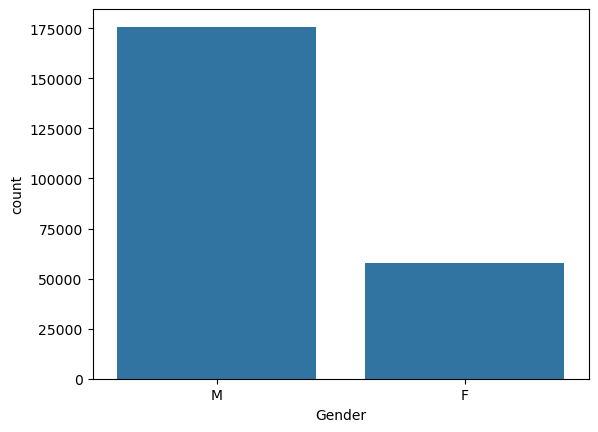

In [49]:
sns.countplot(data=df, x='Gender')

<Axes: xlabel='Age'>

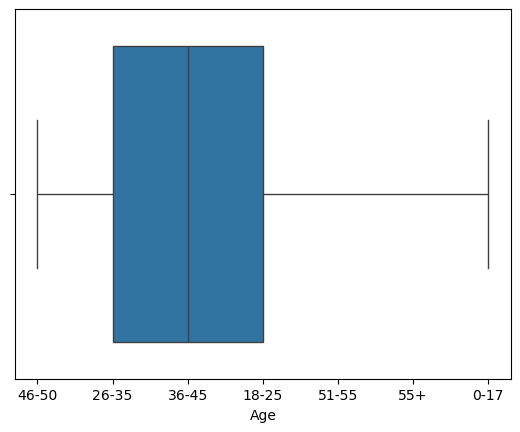

In [50]:
sns.boxplot(data=df, x='Age')

<Axes: xlabel='Age', ylabel='count'>

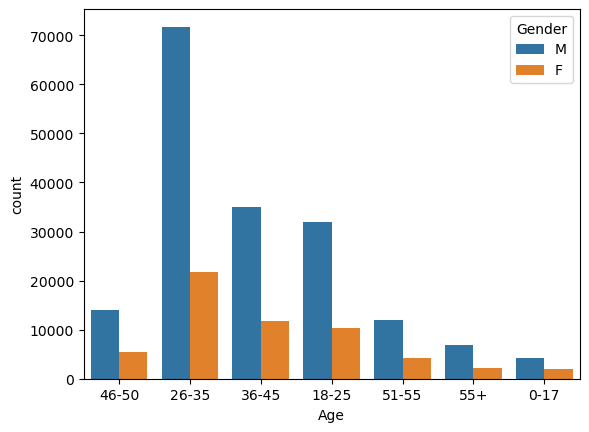

In [51]:
sns.countplot(data=df, x='Age', hue='Gender')

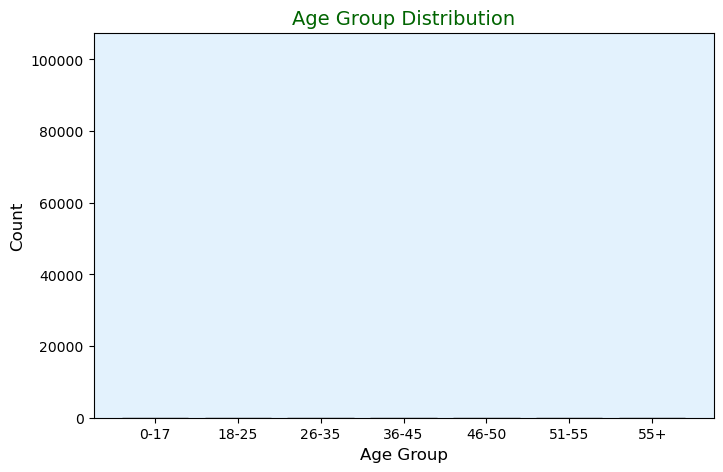

In [52]:
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import matplotlib as mpl
from IPython.display import HTML

plt.style.use('default')

age_counts = df['Age'].value_counts().sort_index()
categories = age_counts.index.astype(str)
colors = sns.color_palette("husl", len(categories))

fig, ax = plt.subplots(figsize=(8,5))
fig.patch.set_facecolor('white')
ax.set_facecolor('#E3F2FD')

bars = ax.bar(categories, [0]*len(categories), color=colors, edgecolor='#333')

ax.set_title("Age Group Distribution", fontsize=14, color='darkgreen')
ax.set_xlabel("Age Group", fontsize=12)
ax.set_ylabel("Count", fontsize=12)
ax.set_ylim(0, age_counts.max()*1.15)

def init():
    for bar in bars:
        bar.set_height(0)
    return bars

def animate(i):
    bars[i].set_height(age_counts.iloc[i])
    return bars

ani = FuncAnimation(fig, animate, init_func=init,
                    frames=len(bars), interval=600, blit=False, repeat=False)

mpl.rcParams['animation.html'] = 'jshtml'

# 👉 फक्त ही line ठेवा, बाकी काहीही नाही
HTML(ani.to_jshtml())

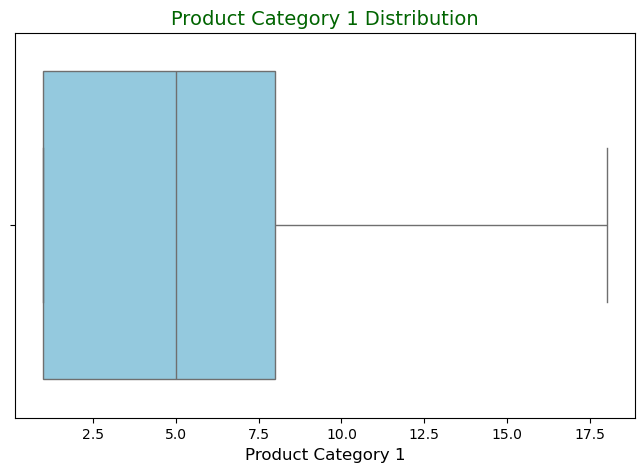

In [53]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(8,5))
sns.boxplot(x=df['Product_Category_1'], color='skyblue')

plt.title("Product Category 1 Distribution", fontsize=14, color='darkgreen')
plt.xlabel("Product Category 1", fontsize=12)
plt.show()

<Axes: >

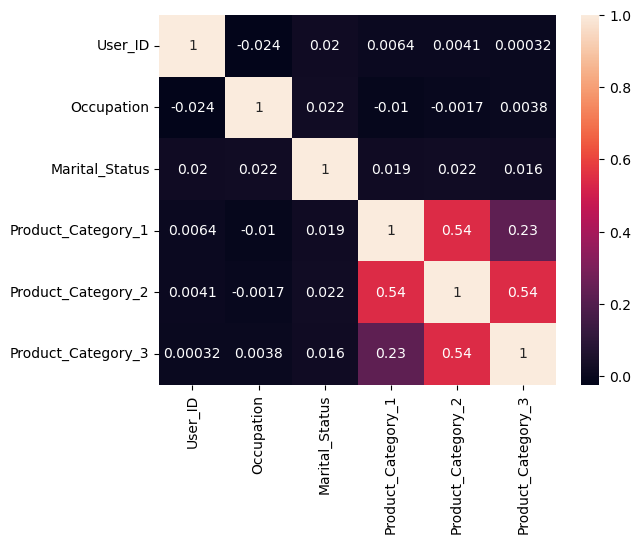

In [54]:
data = df.select_dtypes(include=['int64','float64'])
sns.heatmap(data.corr(), annot=True)

In [55]:
df2.sort_values(by=['Product_Category_1'])

,User_ID,Product_ID,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category_1,Product_Category_2,Product_Category_3,Purchase
196240,1000284,P00359242,M,26-35,12,B,3,1,1,5.0,17.0,18998
545832,1006028,P0097242,M,18-25,4,A,4+,0,1,16.0,16.0,19682
545836,1006030,P00112542,M,26-35,17,C,1,1,1,11.0,15.0,19023
545838,1006030,P00073842,M,26-35,17,C,1,1,1,15.0,17.0,15437
545839,1006030,P00165442,M,26-35,17,C,1,1,1,15.0,16.0,7979
...,...,...,...,...,...,...,...,...,...,...,...,...
550049,1006011,P00375436,M,36-45,15,C,3,0,20,2.0,11.0,473
550067,1006039,P00371644,F,46-50,0,B,4+,1,20,2.0,11.0,490
550051,1006013,P00375436,F,26-35,20,C,3,0,20,2.0,11.0,489
550055,1006019,P00372445,M,26-35,0,A,4+,0,20,2.0,11.0,238


In [56]:
df3 = df.copy()

df3.dtypes

User_ID                         int64
Product_ID                     object
Gender                         object
Age                            object
Occupation                      int64
City_Category                  object
Stay_In_Current_City_Years     object
Marital_Status                  int64
Product_Category_1              int64
Product_Category_2            float64
Product_Category_3            float64
dtype: object

In [57]:
df3['Age'].describe()

count     233599
unique         7
top        26-35
freq       93428
Name: Age, dtype: object

In [58]:
df3['City_Category'].describe()

count     233599
unique         3
top            B
freq       98566
Name: City_Category, dtype: object

In [59]:
df3['Gender'].unique()

array(['M', 'F'], dtype=object)

In [60]:
df3['Age'].unique()

array(['46-50', '26-35', '36-45', '18-25', '51-55', '55+', '0-17'],
      dtype=object)

In [61]:
df3['Gender'].value_counts()

Gender
M    175772
F     57827
Name: count, dtype: int64

In [62]:
df3['City_Category'].value_counts()

City_Category
B    98566
C    72509
A    62524
Name: count, dtype: int64

In [63]:
df3['Gender'].value_counts(ascending=True)

Gender
F     57827
M    175772
Name: count, dtype: int64

In [64]:
df3['City_Category'].value_counts(ascending=True)

City_Category
A    62524
C    72509
B    98566
Name: count, dtype: int64

In [65]:
df4=df.copy()

df4.max(0)

User_ID                        1006040
Product_ID                    P0099942
Gender                               M
Age                                55+
Occupation                          20
City_Category                        C
Stay_In_Current_City_Years          4+
Marital_Status                       1
Product_Category_1                  18
Product_Category_2                18.0
Product_Category_3                18.0
dtype: object

In [66]:
df4.describe()

,User_ID,Occupation,Marital_Status,Product_Category_1,Product_Category_2,Product_Category_3
count,2.335990e+05,233599.000000,233599.000000,233599.000000,161255.000000,71037.000000
mean,1.003029e+06,8.085407,0.410070,5.276542,9.849586,12.669454
std,1.726505e+03,6.521146,0.491847,3.736380,5.094943,4.125944
min,1.000001e+06,0.000000,0.000000,1.000000,2.000000,3.000000
25%,1.001527e+06,2.000000,0.000000,1.000000,5.000000,9.000000
50%,1.003070e+06,7.000000,0.000000,5.000000,9.000000,14.000000
75%,1.004477e+06,14.000000,1.000000,8.000000,15.000000,16.000000
max,1.006040e+06,20.000000,1.000000,18.000000,18.000000,18.000000


In [67]:
df5=df.select_dtypes(include=['number'])

# view the covariance

df5.cov()

,User_ID,Occupation,Marital_Status,Product_Category_1,Product_Category_2,Product_Category_3
User_ID,2.980819e+06,-270.071348,16.883833,41.465376,35.887998,2.262942
Occupation,-2.700713e+02,42.525351,0.070153,-0.254982,-0.055833,0.102668
Marital_Status,1.688383e+01,0.070153,0.241914,0.034660,0.054509,0.032609
Product_Category_1,4.146538e+01,-0.254982,0.034660,13.960536,9.050243,2.380893
Product_Category_2,3.588800e+01,-0.055833,0.054509,9.050243,25.958443,10.113125
Product_Category_3,2.262942e+00,0.102668,0.032609,2.380893,10.113125,17.023417


In [68]:
# view the correlation

df5.corr()

,User_ID,Occupation,Marital_Status,Product_Category_1,Product_Category_2,Product_Category_3
User_ID,1.000000,-0.023988,0.019883,0.006428,0.004065,0.000316
Occupation,-0.023988,1.000000,0.021872,-0.010465,-0.001685,0.003838
Marital_Status,0.019883,0.021872,1.000000,0.018860,0.021766,0.016119
Product_Category_1,0.006428,-0.010465,0.018860,1.000000,0.540063,0.225054
Product_Category_2,0.004065,-0.001685,0.021766,0.540063,1.000000,0.543417
Product_Category_3,0.000316,0.003838,0.016119,0.225054,0.543417,1.000000


In [69]:
# view the top 25 rows of ranked dataframe

df5.rank(1).head(25)

,User_ID,Occupation,Marital_Status,Product_Category_1,Product_Category_2,Product_Category_3
0,5.0,3.0,1.5,1.5,4.0,NaN
1,5.0,4.0,1.0,2.0,3.0,NaN
2,5.0,1.5,1.5,3.0,4.0,NaN
3,5.0,1.5,1.5,3.0,4.0,NaN
4,6.0,2.0,1.0,3.0,4.0,5.0
5,6.0,1.5,1.5,3.0,4.0,5.0
6,6.0,2.0,2.0,2.0,4.0,5.0
7,6.0,1.5,1.5,3.0,4.0,5.0
8,6.0,2.0,1.0,3.0,4.0,5.0
9,5.0,4.0,1.0,2.0,3.0,NaN


In [70]:
df6=df.copy()
df6[['Product_Category_1', 'Product_Category_2', 'Product_Category_3']].aggregate(['mean'])

,Product_Category_1,Product_Category_2,Product_Category_3
mean,5.276542,9.849586,12.669454


In [71]:
df6[['Product_Category_1', 'Product_Category_2', 'Product_Category_3']].aggregate(['sum','mean'])

,Product_Category_1,Product_Category_2,Product_Category_3
sum,1.232595e+06,1.588295e+06,900000.000000
mean,5.276542e+00,9.849586e+00,12.669454


In [72]:
df6.aggregate({'Product_Category_1' : 'sum' ,'Product_Category_2' : 'mean'})

Product_Category_1    1.232595e+06
Product_Category_2    9.849586e+00
dtype: float64

In [73]:
df8=df.copy()

df8.groupby('Gender')

In [74]:
# view groups of Gender column

df8.groupby('Gender').groups

{'F': [2, 3, 4, 14, 18, 23, 24, 25, 33, 34, 39, 41, 43, 44, 47, 48, 50, 51, 52, 75, 76, 77, 83, 84, 108, 109, 110, 111, 113, 114, 115, 119, 147, 149, 155, 156, 157, 160, 163, 170, 184, 185, 186, 187, 188, 189, 190, 191, 207, 209, 211, 212, 223, 224, 225, 235, 245, 246, 247, 249, 250, 281, 286, 294, 295, 296, 297, 298, 299, 310, 312, 320, 321, 322, 323, 330, 334, 335, 336, 337, 339, 340, 341, 351, 353, 358, 364, 365, 371, 372, 380, 381, 382, 383, 384, 385, 386, 387, 388, 410, ...], 'M': [0, 1, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 19, 20, 21, 22, 26, 27, 28, 29, 30, 31, 32, 35, 36, 37, 38, 40, 42, 45, 46, 49, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 78, 79, 80, 81, 82, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 112, 116, 117, 118, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, ...]}

In [75]:
# apply aggregation function sum with groupby

df8.groupby('Gender').sum()

,User_ID,Product_ID,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category_1,Product_Category_2,Product_Category_3
Gender,,,,,,,,,,
F,58008700738,P00288442P00145342P00053842P00159542P00265242P...,36-4536-4526-3526-3518-2546-5046-5046-5051-553...,392173,BBCCAAAABAACAABBCCCCCBAABBBBBBBCCBCCCCCCBBACCB...,4+4+1201114+1101111232223111111111120222111004...,24179,323144,392714.0,200125.0
M,176297953995,P00128942P00113442P00350442P00155442P0094542P0...,46-5026-3546-5046-5046-5026-3518-2526-3526-352...,1496570,BCCCCAABBBBCAACBBCBBBBBBBCCCAACCCCCCCBCCAAACBB...,2033314+22221114+000331111122204+32114+4+4+24+...,71613,909451,1195581.0,699875.0


In [76]:
# alternative way to apply aggregation function sum

df8.groupby('Gender').agg('sum')

,User_ID,Product_ID,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category_1,Product_Category_2,Product_Category_3
Gender,,,,,,,,,,
F,58008700738,P00288442P00145342P00053842P00159542P00265242P...,36-4536-4526-3526-3518-2546-5046-5046-5051-553...,392173,BBCCAAAABAACAABBCCCCCBAABBBBBBBCCBCCCCCCBBACCB...,4+4+1201114+1101111232223111111111120222111004...,24179,323144,392714.0,200125.0
M,176297953995,P00128942P00113442P00350442P00155442P0094542P0...,46-5026-3546-5046-5046-5026-3518-2526-3526-352...,1496570,BCCCCAABBBBCAACBBCBBBBBBBCCCAACCCCCCCBCCAAACBB...,2033314+22221114+000331111122204+32114+4+4+24+...,71613,909451,1195581.0,699875.0


In [77]:
# attribute access in python pandas

df8_grouped = df8.groupby('Gender')

print(df8_grouped.agg(np.size))

        User_ID  Product_ID     Age  Occupation  City_Category  \
Gender                                                           
F         57827       57827   57827       57827          57827   
M        175772      175772  175772      175772         175772   

        Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
Gender                                                                   
F                            57827           57827               57827   
M                           175772          175772              175772   

        Product_Category_2  Product_Category_3  
Gender                                          
F                    57827               57827  
M                   175772              175772  


In [78]:
df10=df.copy()


df10.groupby('Gender').filter(lambda x: len(x) > 4)

,User_ID,Product_ID,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category_1,Product_Category_2,Product_Category_3
0,1000004,P00128942,M,46-50,7,B,2,1,1,11.0,NaN
1,1000009,P00113442,M,26-35,17,C,0,0,3,5.0,NaN
2,1000010,P00288442,F,36-45,1,B,4+,1,5,14.0,NaN
3,1000010,P00145342,F,36-45,1,B,4+,1,4,9.0,NaN
4,1000011,P00053842,F,26-35,1,C,1,0,4,5.0,12.0
...,...,...,...,...,...,...,...,...,...,...,...
233594,1006036,P00118942,F,26-35,15,B,4+,1,8,NaN,NaN
233595,1006036,P00254642,F,26-35,15,B,4+,1,5,8.0,NaN
233596,1006036,P00031842,F,26-35,15,B,4+,1,1,5.0,12.0
233597,1006037,P00124742,F,46-50,1,C,4+,0,10,16.0,NaN


In [79]:
# let's create two dataframes

batsmen = pd.DataFrame({
   'id':[1,2,3,4,5],
   'Name': ['Rohit', 'Dhawan', 'Virat', 'Dhoni', 'Kedar'],
   'subject_id':['sub1','sub2','sub4','sub6','sub5']})

bowler = pd.DataFrame(
   {'id':[1,2,3,4,5],
   'Name': ['Kumar', 'Bumrah', 'Shami', 'Kuldeep', 'Chahal'],
   'subject_id':['sub2','sub4','sub3','sub6','sub5']})


print(batsmen)


print(bowler)

   id    Name subject_id
0   1   Rohit       sub1
1   2  Dhawan       sub2
2   3   Virat       sub4
3   4   Dhoni       sub6
4   5   Kedar       sub5
   id     Name subject_id
0   1    Kumar       sub2
1   2   Bumrah       sub4
2   3    Shami       sub3
3   4  Kuldeep       sub6
4   5   Chahal       sub5


In [80]:
# merge two dataframes on a key

pd.merge(batsmen, bowler, on='id')

,id,Name_x,subject_id_x,Name_y,subject_id_y
0,1,Rohit,sub1,Kumar,sub2
1,2,Dhawan,sub2,Bumrah,sub4
2,3,Virat,sub4,Shami,sub3
3,4,Dhoni,sub6,Kuldeep,sub6
4,5,Kedar,sub5,Chahal,sub5


In [81]:
# merge two dataframes on multiple keys

pd.merge(batsmen, bowler, on=['id', 'subject_id'])

,id,Name_x,subject_id,Name_y
0,4,Dhoni,sub6,Kuldeep
1,5,Kedar,sub5,Chahal


In [82]:
# left join


pd.merge(batsmen, bowler, on='subject_id', how='left')

,id_x,Name_x,subject_id,id_y,Name_y
0,1,Rohit,sub1,NaN,NaN
1,2,Dhawan,sub2,1.0,Kumar
2,3,Virat,sub4,2.0,Bumrah
3,4,Dhoni,sub6,4.0,Kuldeep
4,5,Kedar,sub5,5.0,Chahal


In [83]:
# right join

pd.merge(batsmen, bowler, on='subject_id', how='right')

,id_x,Name_x,subject_id,id_y,Name_y
0,2.0,Dhawan,sub2,1,Kumar
1,3.0,Virat,sub4,2,Bumrah
2,NaN,NaN,sub3,3,Shami
3,4.0,Dhoni,sub6,4,Kuldeep
4,5.0,Kedar,sub5,5,Chahal


In [84]:
# outer join

pd.merge(batsmen, bowler, on='subject_id', how='outer')

,id_x,Name_x,subject_id,id_y,Name_y
0,1.0,Rohit,sub1,NaN,NaN
1,2.0,Dhawan,sub2,1.0,Kumar
2,NaN,NaN,sub3,3.0,Shami
3,3.0,Virat,sub4,2.0,Bumrah
4,5.0,Kedar,sub5,5.0,Chahal
5,4.0,Dhoni,sub6,4.0,Kuldeep


In [85]:
# inner join

pd.merge(batsmen, bowler, on='subject_id', how='inner')

,id_x,Name_x,subject_id,id_y,Name_y
0,2,Dhawan,sub2,1,Kumar
1,3,Virat,sub4,2,Bumrah
2,4,Dhoni,sub6,4,Kuldeep
3,5,Kedar,sub5,5,Chahal


In [86]:
# let's create two dataframes

batsmen = pd.DataFrame({
   'id':[1,2,3,4,5],
   'Name': ['Rohit', 'Dhawan', 'Virat', 'Dhoni', 'Kedar'],
   'subject_id':['sub1','sub2','sub4','sub6','sub5']})

bowler = pd.DataFrame(
   {'id':[1,2,3,4,5],
   'Name': ['Kumar', 'Bumrah', 'Shami', 'Kuldeep', 'Chahal'],
   'subject_id':['sub2','sub4','sub3','sub6','sub5']})


print(batsmen)


print(bowler)

   id    Name subject_id
0   1   Rohit       sub1
1   2  Dhawan       sub2
2   3   Virat       sub4
3   4   Dhoni       sub6
4   5   Kedar       sub5
   id     Name subject_id
0   1    Kumar       sub2
1   2   Bumrah       sub4
2   3    Shami       sub3
3   4  Kuldeep       sub6
4   5   Chahal       sub5


In [87]:
# concatenate the dataframes


team=[batsmen, bowler]

pd.concat(team)

,id,Name,subject_id
0,1,Rohit,sub1
1,2,Dhawan,sub2
2,3,Virat,sub4
3,4,Dhoni,sub6
4,5,Kedar,sub5
0,1,Kumar,sub2
1,2,Bumrah,sub4
2,3,Shami,sub3
3,4,Kuldeep,sub6
4,5,Chahal,sub5


In [88]:
# associate keys with the dataframes

pd.concat(team, keys=['x', 'y'])

id     Name subject_id
x 0   1    Rohit       sub1
  1   2   Dhawan       sub2
  2   3    Virat       sub4
  3   4    Dhoni       sub6
  4   5    Kedar       sub5
y 0   1    Kumar       sub2
  1   2   Bumrah       sub4
  2   3    Shami       sub3
  3   4  Kuldeep       sub6
  4   5   Chahal       sub5

In [89]:
pd.concat(team, keys=['x', 'y'], ignore_index=True)

,id,Name,subject_id
0,1,Rohit,sub1
1,2,Dhawan,sub2
2,3,Virat,sub4
3,4,Dhoni,sub6
4,5,Kedar,sub5
5,1,Kumar,sub2
6,2,Bumrah,sub4
7,3,Shami,sub3
8,4,Kuldeep,sub6
9,5,Chahal,sub5


In [90]:
pd.concat(team, axis=1)

,id,Name,subject_id,id,Name,subject_id
0,1,Rohit,sub1,1,Kumar,sub2
1,2,Dhawan,sub2,2,Bumrah,sub4
2,3,Virat,sub4,3,Shami,sub3
3,4,Dhoni,sub6,4,Kuldeep,sub6
4,5,Kedar,sub5,5,Chahal,sub5


In [91]:
df11=df.copy()

df11.columns

Index(['User_ID', 'Product_ID', 'Gender', 'Age', 'Occupation', 'City_Category',
       'Stay_In_Current_City_Years', 'Marital_Status', 'Product_Category_1',
       'Product_Category_2', 'Product_Category_3'],
      dtype='object')

In [92]:
df12=df.copy()
df12=(pd.melt(frame=df11, id_vars=['User_ID','Product_ID', 'Gender','Age','Occupation','City_Category',
                             'Marital_Status'],                          
                   
              value_vars=['Product_Category_1','Product_Category_2','Product_Category_3'], 
                    var_name='Product_Category', value_name='Amount'))

df12.head(10)

,User_ID,Product_ID,Gender,Age,Occupation,City_Category,Marital_Status,Product_Category,Amount
0,1000004,P00128942,M,46-50,7,B,1,Product_Category_1,1.0
1,1000009,P00113442,M,26-35,17,C,0,Product_Category_1,3.0
2,1000010,P00288442,F,36-45,1,B,1,Product_Category_1,5.0
3,1000010,P00145342,F,36-45,1,B,1,Product_Category_1,4.0
4,1000011,P00053842,F,26-35,1,C,0,Product_Category_1,4.0
5,1000013,P00350442,M,46-50,1,C,1,Product_Category_1,2.0
6,1000013,P00155442,M,46-50,1,C,1,Product_Category_1,1.0
7,1000013,P0094542,M,46-50,1,C,1,Product_Category_1,2.0
8,1000015,P00161842,M,26-35,7,A,0,Product_Category_1,10.0
9,1000022,P00067942,M,18-25,15,A,0,Product_Category_1,5.0


In [93]:
df13=df12[['Product_Category', 'Amount']]

df14=df13.pivot_table(index=None, columns='Product_Category', values='Amount')

df14.head(25)

Product_Category,Product_Category_1,Product_Category_2,Product_Category_3
Amount,5.276542,9.849586,12.669454


In [94]:
df15=df14.stack()

df15

        Product_Category  
Amount  Product_Category_1     5.276542
        Product_Category_2     9.849586
        Product_Category_3    12.669454
dtype: float64

In [95]:
df15.unstack()

Product_Category,Product_Category_1,Product_Category_2,Product_Category_3
Amount,5.276542,9.849586,12.669454


In [96]:
# display maximum rows

pd.get_option("display.max_rows")

60

In [97]:
# display maximum columns

pd.get_option("display.max_columns")

20

In [98]:
# set maximum rows

pd.set_option("display.max_rows", 80)

pd.get_option("display.max_rows")

80

In [99]:
# set maximum columns

pd.set_option("display.max_columns", 30)

pd.get_option("display.max_columns")

30

In [100]:
# display maximum rows

pd.reset_option("display.max_rows")

pd.get_option("display.max_rows")

60

In [101]:
# display maximum columns

pd.reset_option("display.max_columns")

pd.get_option("display.max_columns")

20

In [102]:
# description of the display maximum rows parameter

pd.describe_option("display.max_rows")

display.max_rows : int
    If max_rows is exceeded, switch to truncate view. Depending on
    `large_repr`, objects are either centrally truncated or printed as
    a summary view. 'None' value means unlimited.

    In case python/IPython is running in a terminal and `large_repr`
    equals 'truncate' this can be set to 0 and pandas will auto-detect
    the height of the terminal and print a truncated object which fits
    the screen height. The IPython notebook, IPython qtconsole, or
    IDLE do not run in a terminal and hence it is not possible to do
    correct auto-detection.
    [default: 60] [currently: 60]


In [103]:
# set the parameter value with option_context

with pd.option_context("display.max_rows",10):
   print(pd.get_option("display.max_rows"))
   print(pd.get_option("display.max_rows"))

10
10


In [104]:
print("Project Completed: Data cleaned, analyzed & insights generated using Pandas")


Project Completed: Data cleaned, analyzed & insights generated using Pandas


This concludes our discussion on Pandas and its data analysis tools.

So, now we will come to the end of this kernel.

I hope you find this kernel useful and enjoyable.

Your comments and feedback are most welcome.

Thank you


[Go to Top](#0)